<img src="data/Airbnb-Login.jpg">

# Section Overview

In this section I want to get a better understanding of the relationship between certain features with the target value as well as implement visualizations of the data. 

# Setup

In [1]:
# Common Libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Maps
import plotly.express as px
import folium
from folium.plugins import FastMarkerCluster
import geopandas as gpd
from branca.colormap import LinearColormap

# Feature Engineering
import re
from collections import Counter
from datetime import datetime
from geopy.distance import great_circle

# Display options:
sns.set(style="white", palette="pastel",font_scale=1.5, rc={"lines.linewidth": 2.5,'figure.figsize':(11.7,8.27)})
pd.set_option('display.max_columns', None)

# Deal with warnings:
import warnings
warnings.simplefilter(action = 'ignore', category=FutureWarning)
warnings.filterwarnings('ignore')
def ignore_warn(*args, **kwargs):
    pass
warnings.warn = ignore_warn

# Data Exploration / Visualizaton

In [2]:
df = pd.read_csv('data/raw_data_preprocessed')
df.rename(columns={'Unnamed: 0': 'id'}, inplace=True)
df.set_index('id', inplace = True)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 64426 entries, 3109 to 42912016
Data columns (total 59 columns):
accommodates                      64426 non-null int64
bathrooms                         64426 non-null float64
bedrooms                          64426 non-null float64
cleaning_fee                      64426 non-null float64
security_deposit                  64426 non-null float64
extra_people                      64426 non-null float64
guests_included                   64426 non-null int64
distance                          64426 non-null float64
size                              64426 non-null float64
listing_url                       64426 non-null object
description                       64426 non-null object
host_since                        64426 non-null object
host_response_time                64426 non-null object
host_response_rate                64426 non-null object
host_acceptance_rate              64426 non-null object
host_is_superhost                 64426 

In [4]:
# In this section we fill the missing values with unknown and transform the time columns
# back to the datetime format
df.review_scores_rating.fillna('unknown', inplace=True)
df.review_scores_accuracy.fillna('unknown', inplace=True)
df.review_scores_cleanliness.fillna('unknown', inplace=True)
df.review_scores_checkin.fillna('unknown', inplace=True)
df.review_scores_communication.fillna('unknown', inplace=True)
df.review_scores_location.fillna('unknown', inplace=True)
df.review_scores_value.fillna('unknown', inplace=True)
df.time_since_first_review.fillna('unknown', inplace=True)
df.time_since_last_review.fillna('unknown', inplace=True)
df['host_since'] = pd.to_datetime(df['host_since'])
df['first_review'] = pd.to_datetime(df['first_review'])
df['last_review'] = pd.to_datetime(df['last_review'])

In [5]:
object_features = list(df.select_dtypes(include=[np.object]).columns.values)
boolean_features = list(df.select_dtypes(include=[np.bool]).columns.values)
numeric_features = list(df.select_dtypes(include=[np.int,np.float]).columns.values)

## Let's have a look at the numerical features

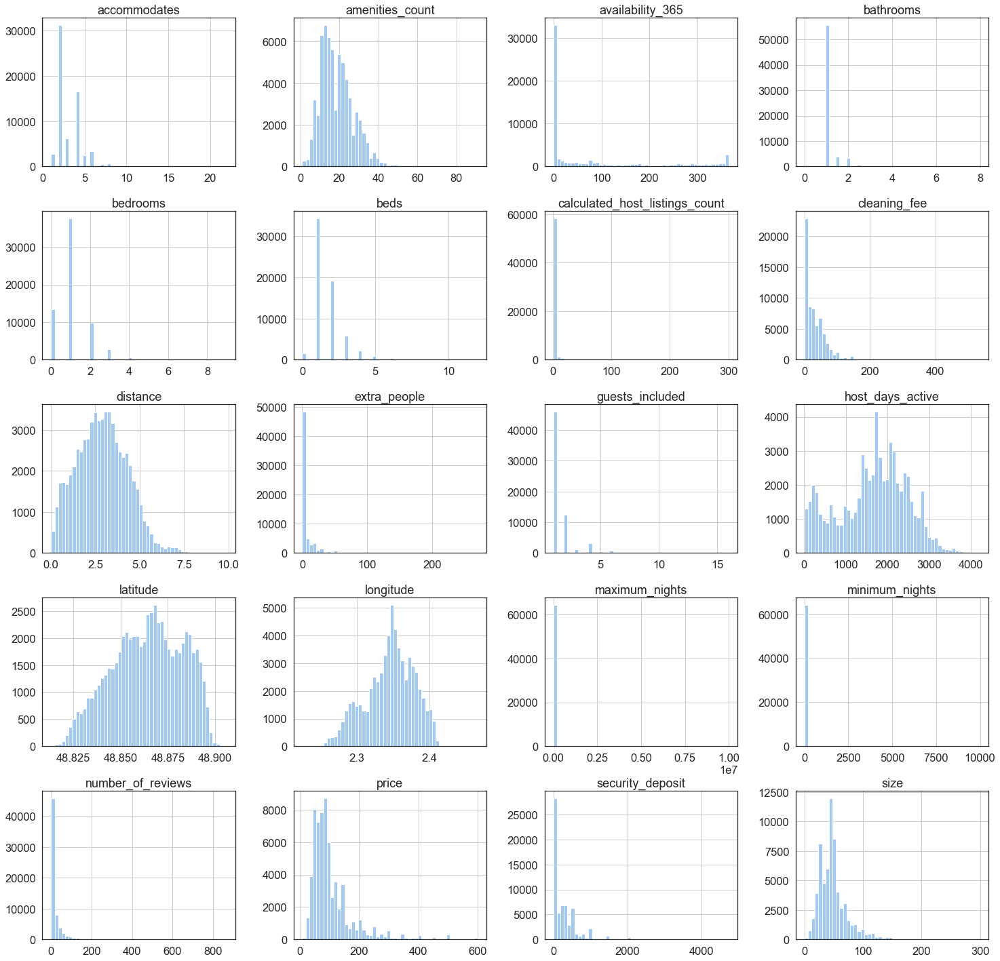

In [6]:
df[numeric_features].hist(bins=50,figsize=(25,25));

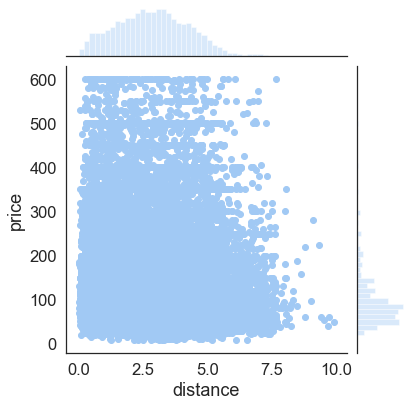

In [8]:
sns.jointplot(x=df.distance, y=df.price);

There seems to be a relationship between price and distance, the farther away the cheaper.

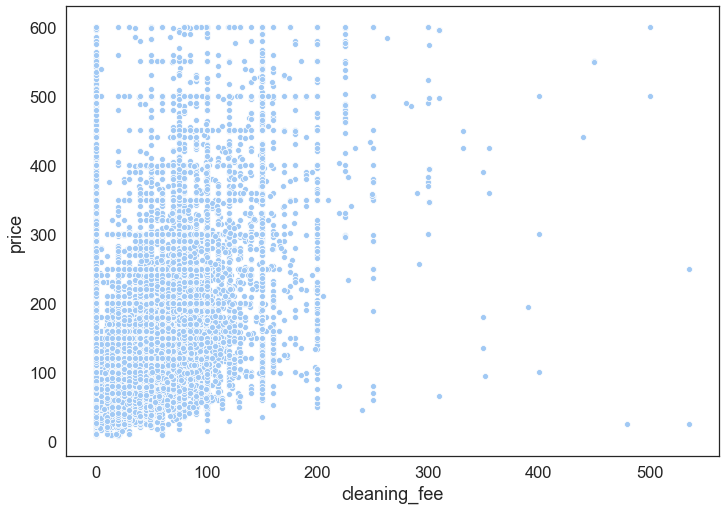

In [9]:
sns.scatterplot(x=df.cleaning_fee, y=df.price);

In the lower price segment more reviews tend to lead to higher prices.

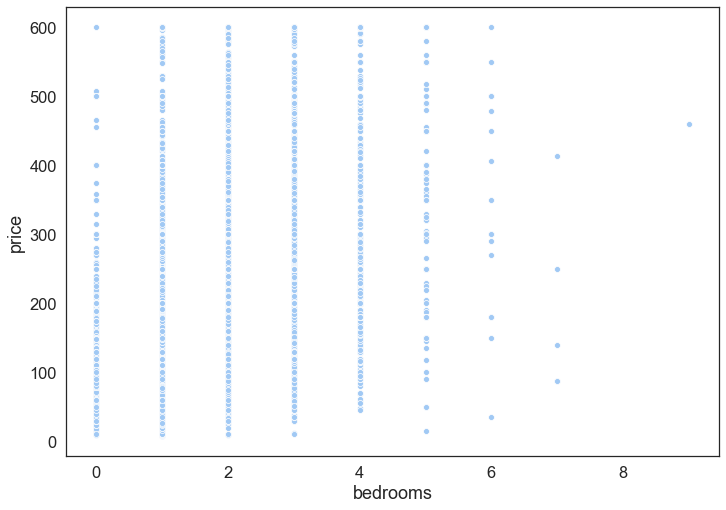

In [10]:
sns.scatterplot(x=df.bedrooms, y=df.price);

More bedrooms usually lead to higher prices.

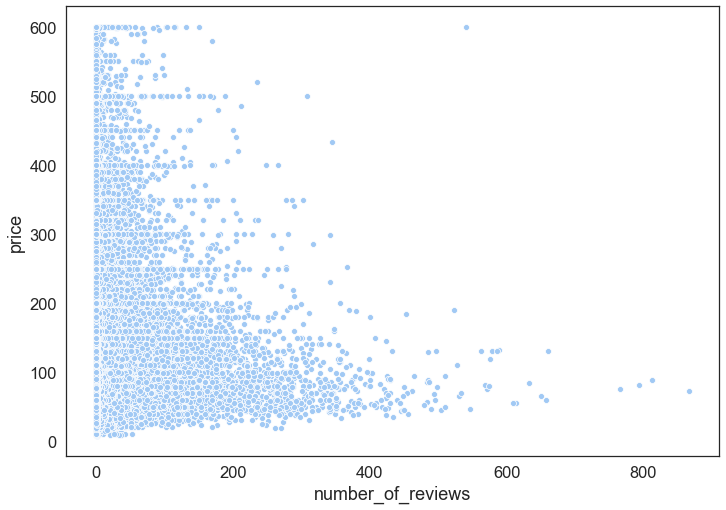

In [11]:
sns.scatterplot(x=df.number_of_reviews, y=df.price);

In the lower price segment more reviews tend to lead to higher prices.

## Relationship betweet Object Features and Price

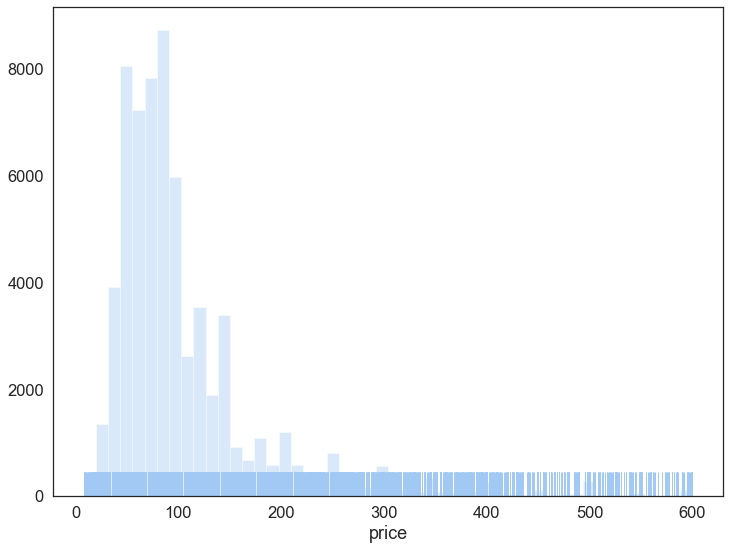

In [12]:
f, ax = plt.subplots(figsize=(12, 9))
sns.distplot(df['price'], kde=False, rug=True);

In [13]:
object_features = list(df.select_dtypes(include=[np.object]).columns.values)

In [14]:
object_features

['listing_url',
 'description',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'neighbourhood',
 'property_type',
 'room_type',
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value',
 'cancellation_policy',
 'time_since_first_review',
 'time_since_last_review']

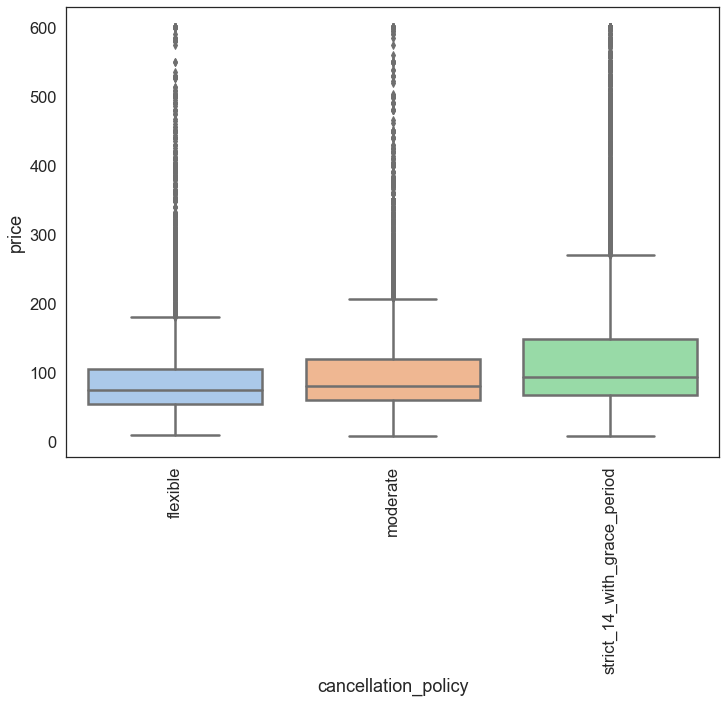

In [16]:
sorted_nb = df.groupby(['cancellation_policy'])['price'].median().sort_values()
sns.boxplot(x=df['cancellation_policy'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

Listings with a stinct cancellation policy tend to have higher prices.

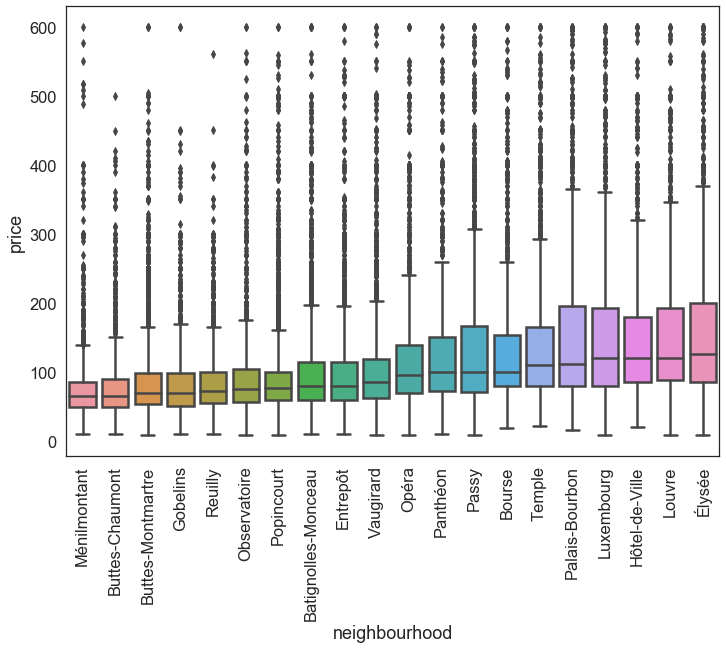

In [17]:
# median price per neighbourhood
sorted_nb = df.groupby(['neighbourhood'])['price'].median().sort_values()
sns.boxplot(x=df['neighbourhood'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

Elysee has the highest median price compared to the other neighboorhoods.

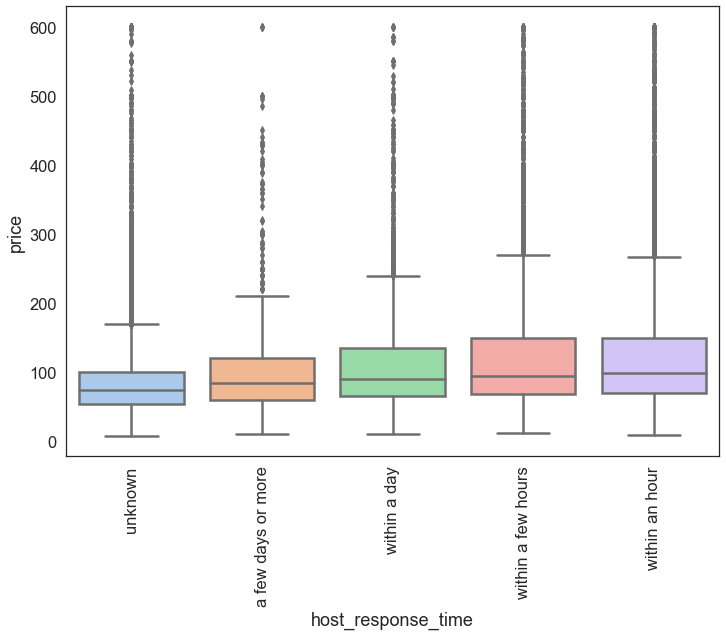

In [18]:
sorted_nb = df.groupby(['host_response_time'])['price'].median().sort_values()
sns.boxplot(x=df['host_response_time'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

Listings where the host answers within an hour tend to be more expensive.

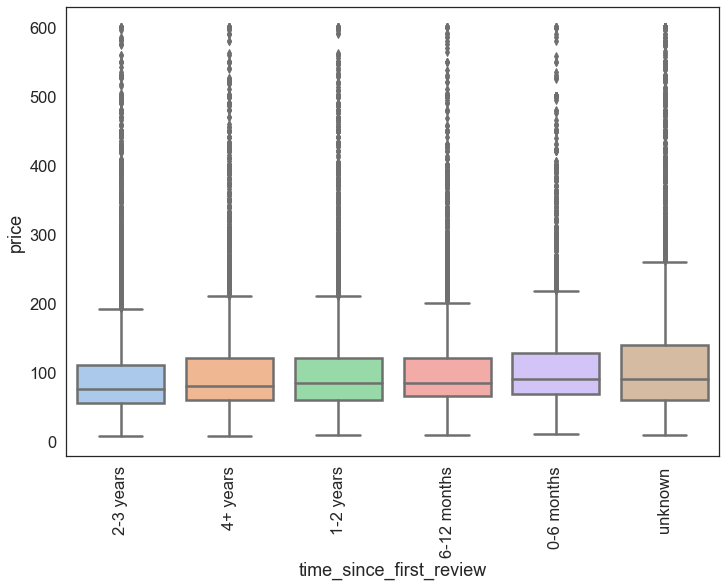

In [19]:
sorted_nb = df.groupby(['time_since_first_review'])['price'].median().sort_values()
sns.boxplot(x=df['time_since_first_review'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

Places that recently hat der first review tend to be a bit more expensive. 

## Boolean Features

In [20]:
boolean_features

['host_is_superhost',
 'host_identity_verified',
 'instant_bookable',
 'bed_linen',
 'breakfast',
 'tv',
 'coffee_machine',
 'cooking_basics',
 'household appliance',
 'elevator',
 'child_friendly',
 'parking',
 'host_greeting',
 'internet',
 'long_term_stays',
 'private_entrance',
 'smoking_allowed',
 'subway']

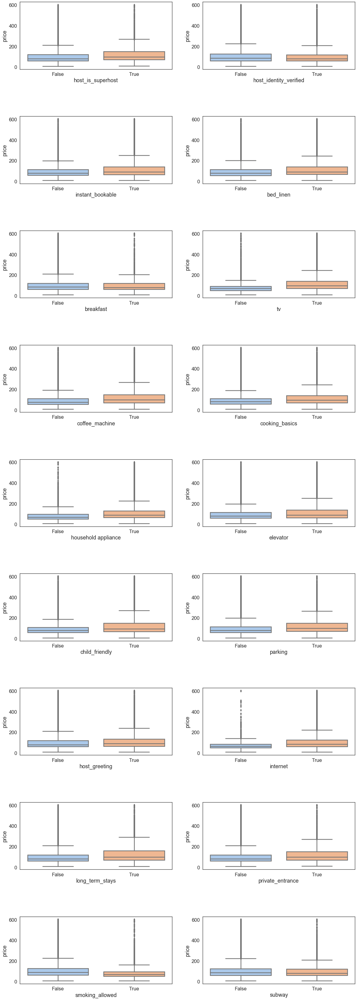

In [21]:
fig, ax = plt.subplots(ncols=2, nrows=9,figsize=(20,60),gridspec_kw={'hspace': 0.7})

for idx, elm in enumerate(boolean_features):
    sns.boxplot(x=df[elm], y=df['price'], ax=ax[int(idx/2)][idx%2]);

When it comes to amenities, a lot of observations can be made that lead to higher median prices: private entrance, long term stays, host greeting, internet, parking, childfriendly, household appliance, elevator, cooking basics, coffee machine, tv, instant bookable, superhost, bed linen. 
**It is quite surprising that you travel to Paris to watch TV.**

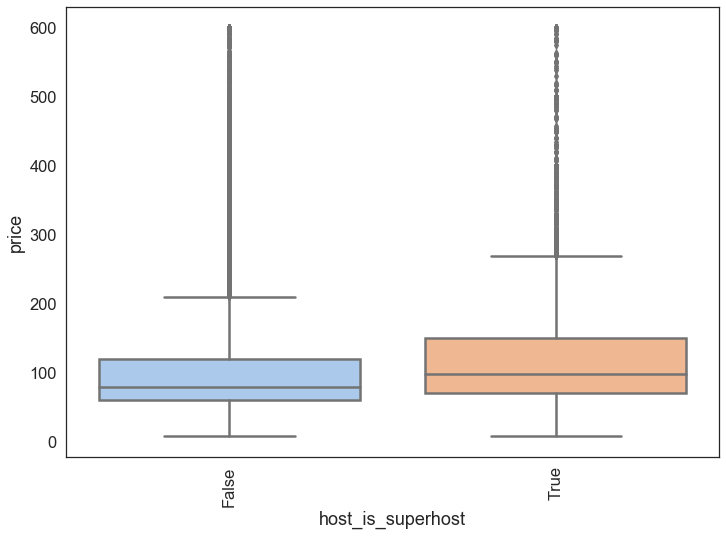

In [22]:
sorted_nb = df.groupby(['host_is_superhost'])['price'].median().sort_values()
sns.boxplot(x=df['host_is_superhost'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

Apartments of superhost are in general more expensive, it probably has a marketing effect. 
To become a superhost these four criteria must be met:
* Host a minimum of 10 stays in a year.
* Respond to guests quickly and maintain a 90% response rate or higher.
* Have at least 80% 5-star reviews.
* Honor confirmed reservations (meaning hosts should rarely cancel)

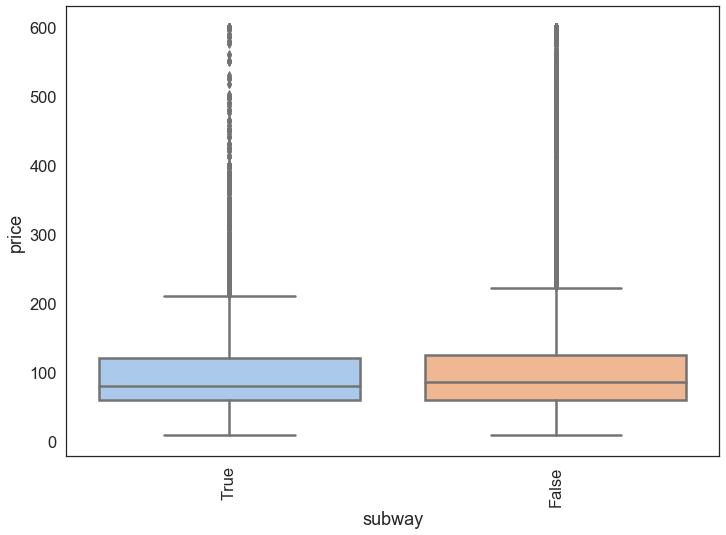

In [23]:
sorted_nb = df.groupby(['subway'])['price'].median().sort_values()
sns.boxplot(x=df['subway'], y=df['price'], order=list(sorted_nb.index));
plt.xticks(rotation=90);

The subway extraction from the description did not end up in a valuable feature. It will be dropped later. 

In [39]:
# One way we could improve our model and analysis is to logarithmic certain features and the price, but I chose not to do it.
#log_price = np.log(df.price)
#log_distance = np.log(df.distance)

## Time Series

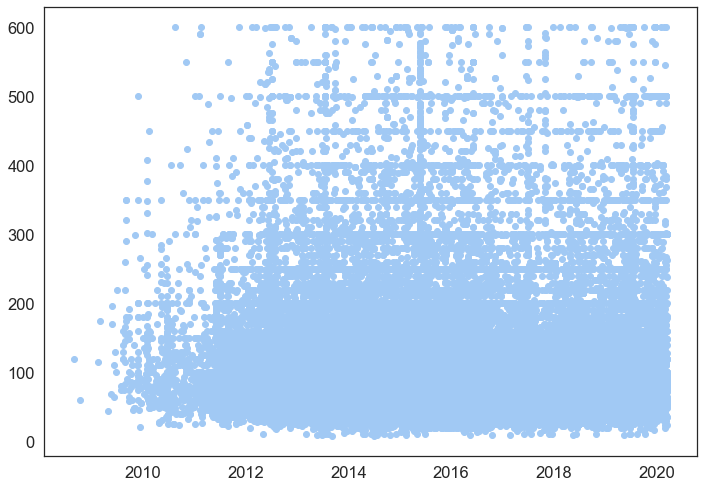

In [26]:
plt.plot_date(df.host_since,df.price);

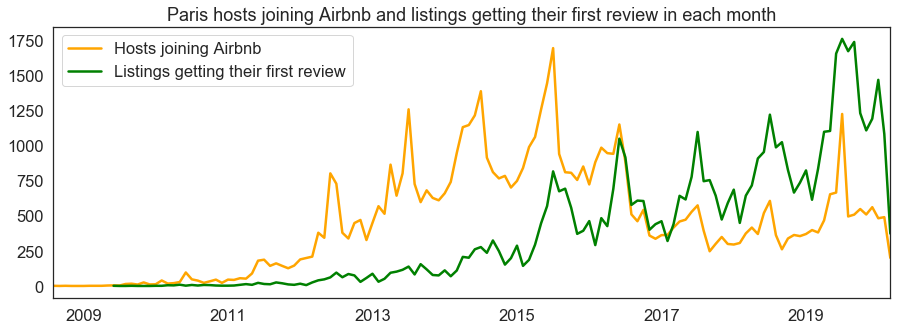

In [27]:
plt.figure(figsize=(15,5))
df.set_index('host_since').resample('MS').size().plot(label='Hosts joining Airbnb', color='orange')
df.set_index('first_review').resample('MS').size().plot(label='Listings getting their first review', color='green')
#df.set_index('last_review').resample('MS').size().plot(label='Listings getting their last review', color='black')
plt.title('Paris hosts joining Airbnb and listings getting their first review in each month')
plt.legend()
plt.xlim('2008-08-01', '2020-03-31') # Limiting to whole months
plt.xlabel('')
plt.ylabel('')
plt.show()

From about 2009 until 2016 the number of host joing Airbnb steadily grew. There are several effects that could explain why this trend stopped. Since the first reviews keep going up, possibly some host started to make a business out of it therefore owned more and more places. At the end we see a large drop which is probably caused due to corona crises. Moreover we can see a trend of seasonality in the graph, maybe because in the summer there are more tourists in Paris.

## Location / Density and Price of Listings in Paris

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


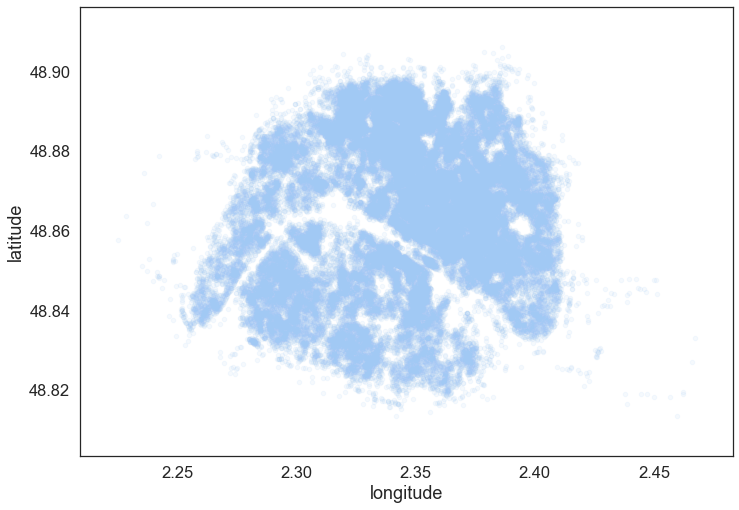

In [28]:
df.plot(kind='scatter', x='longitude', y='latitude', alpha=0.1);

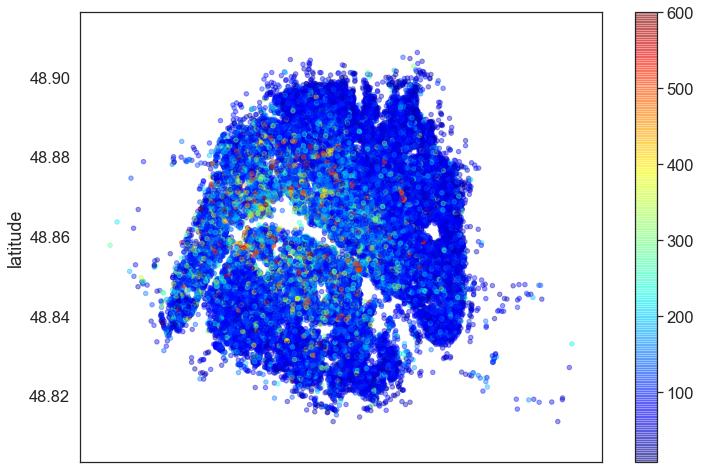

In [29]:
df.plot(kind='scatter', x='longitude', y='latitude', alpha=0.4, 
       c=df['price'], cmap=plt.get_cmap('jet'), colorbar=True);

Especially near the Seine River apartments seem to be expensive, 
further to the north and to the east they seem and farther away from the Seine River they seem to be cheaper.

In [30]:
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", hover_name="price", hover_data=["listing_url"], color="price",
                        color_discrete_sequence=["fuchsia"], zoom=10, height=300)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## Number of listings by neighbourhood

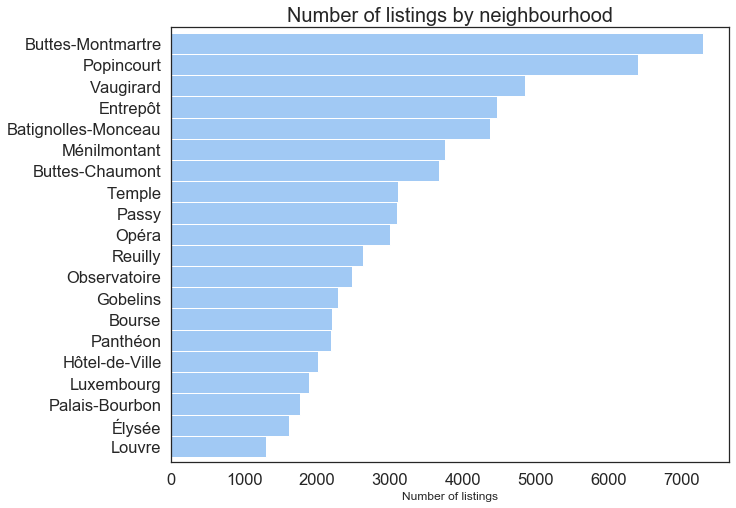

<Figure size 842.4x595.44 with 0 Axes>

In [31]:
freq=df['neighbourhood'].value_counts().sort_values(ascending=True)
freq.plot.barh(figsize=(10, 8), color='b', width=1)
plt.title("Number of listings by neighbourhood", fontsize=20)
plt.xlabel('Number of listings', fontsize=12)
plt.show()
plt.savefig('data/number_of_listings', tranparent=True);

Most listings can be found in Buttes-Montmarte and Popincourt, which is in the North and in the East of the city.

In [32]:
# Let's have a look on how the appartments are clustered.
lats2020 = df['latitude'].tolist()
lons2020 = df['longitude'].tolist()
locations = list(zip(lats2020, lons2020))

map1 = folium.Map(location=[48.864716, 2.349014], zoom_start=11.5)
FastMarkerCluster(data=locations).add_to(map1)
map1

## Mean daily price per neighbourhood in general

In [33]:
df_neighboorhood = df.groupby('neighbourhood').agg(lambda x: x.tolist())

In [34]:
df_neighboorhood.loc[:, 'mean_price'] = df_neighboorhood.price.map(lambda x: np.mean(x))
df_neighboorhood.reset_index(inplace=True)

In [35]:
import json
with open('data/neighbourhoods_paris.geojson') as response:
    geo_data = json.load(response)

import plotly.express as px
fig = px.choropleth(df_neighboorhood, geojson=geo_data, locations='neighbourhood',featureidkey="properties.neighbourhood", color='mean_price',
                           color_continuous_scale="Viridis",scope="europe", hover_data=["neighbourhood"],
                           labels={'price':'mean_price'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

## Mean daily price per neighbourhood for 2-persons accomodation

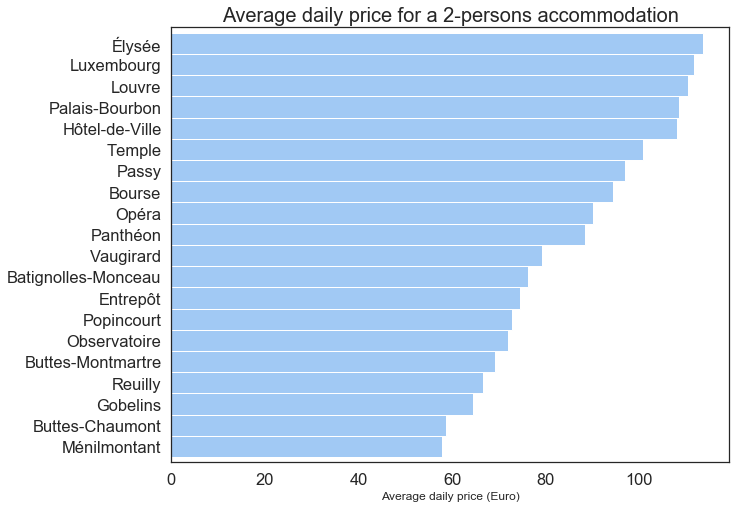

In [36]:
feq = df[df['accommodates']==2]
feq = feq.groupby('neighbourhood')['price'].mean().sort_values(ascending=True)
feq.plot.barh(figsize=(10, 8), color='b', width=1)
plt.title("Average daily price for a 2-persons accommodation", fontsize=20)
plt.xlabel('Average daily price (Euro)', fontsize=12)
plt.ylabel("")
plt.show()

If as a couple you do not want to spend too much money on accomondation, Gobelins, Buttes-Chaumont and Ménilmontant could be good neighbourhoods to stay if you are near a metro station.
Buttes Montmarte offers the most accomondation and is also quite cheap.

In [37]:
adam = gpd.read_file("data/neighbourhoods_paris.geojson")
feq = pd.DataFrame([feq])
feq = feq.transpose()
adam = pd.merge(adam, feq, on='neighbourhood', how='left')
adam.rename(columns={'price': 'average_price'}, inplace=True)
adam.average_price = adam.average_price.round(decimals=0)

map_dict = adam.set_index('neighbourhood')['average_price'].to_dict()
color_scale = LinearColormap(['yellow','red'], vmin = min(map_dict.values()), vmax = max(map_dict.values()))

def get_color(feature):
    value = map_dict.get(feature['properties']['neighbourhood'])
    return color_scale(value)

map3 = folium.Map(location=[48.864716, 2.349014], zoom_start=11)
folium.GeoJson(data=adam,
               name='Paris',
               tooltip=folium.features.GeoJsonTooltip(fields=['neighbourhood', 'average_price'],
                                                      labels=True,
                                                      sticky=False),
               style_function= lambda feature: {
                   'fillColor': get_color(feature),
                   'color': 'black',
                   'weight': 1,
                   'dashArray': '5, 5',
                   'fillOpacity':0.5
                   },
               highlight_function=lambda feature: {'weight':3, 'fillColor': get_color(feature), 'fillOpacity': 0.8}).add_to(map3)
map3

With a mean price of 58 Euros for two people Ménilmontant offers a cheap possiblity to discover Paris. Buttes-Chaument also offers good prices.

In [38]:
df_model = df.drop(['listing_url', 'subway', 'description', 'host_since', 'latitude', 'longitude','first_review','last_review'], axis=1)
df_model.to_csv('data/df_model')